In [25]:
import numpy as np
import matplotlib.pyplot as plt
import sympy as smp
from scipy.integrate import odeint
import plotly.graph_objects as go
from IPython.display import HTML
from scipy.optimize import curve_fit
import matplotlib.animation as animation
from matplotlib.animation import PillowWriter
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import Axes3D
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.patches import FancyArrowPatch
from mpl_toolkits.mplot3d import proj3d
from matplotlib.animation import FuncAnimation, PillowWriter
from mpl_toolkits.mplot3d.proj3d import proj_transform
from matplotlib.animation import FuncAnimation, FFMpegWriter

from gyroscope import Solve_Gyro, Solve_Gyro_Forced_X, Solve_Gyro_Forced_XY, Solve_Gyro_Forced_Y, Solve_Gyro_Free, Get_Gyro_Position
from gyroscope import Get_Gyro_Position_X, Demo

Precession frequency = 0.2681110664877756
Rotation frequency = 199.83098289616436
Gyros number (frequency) = 745.3291112296387
Gyros number (parameters) = 754.219537790775
Gyros number gap = 1.1787584536960902 %
Larmor frequency =  0.26495068462625615  Hz


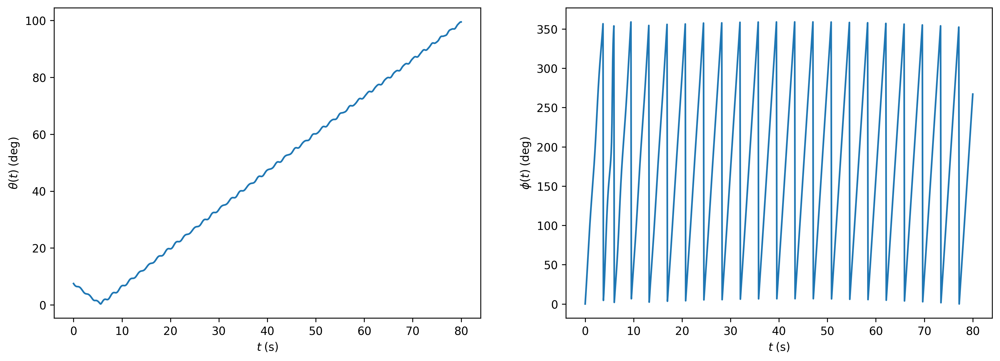

99.50378502512315
0.3179432899038112


In [2]:
CI = [np.pi / 24, 0, 0, 0, 0, 2*np.pi*200]

t = np.linspace(0, 80, 1000)

g_ = 9.81
r = 53 / 2 * 1e-3
e = 12 * 1e-3
m_ = 0.375
#J3_ = m_ * (r**2) / 2
#J1_ = J3_ + m_ * e**2 / 12
J3_ = 0.000055
J1_ = 0.000055
h_ = 31.25 * 1e-3

x0_ = 10 * 1e-2
omega_f =  0.265
params_f = [g_, m_, h_, J1_, J3_, x0_, 0,  omega_f]



the_f, phi_f, psi_f, the, _, _, _, _, _, path_f = Solve_Gyro_Forced_X(t, CI, params_f)

print(np.max(the_f) * 180 / np.pi)
print(np.min(the_f) * 180 / np.pi)

#path_f

Precession frequency = 0.26892092761803965
Rotation frequency = 199.80710119045023
Gyros number (frequency) = 742.9957309765239
Gyros number (parameters) = 754.0392757265184
Gyros number gap = 1.464584817462471 %
Larmor frequency =  0.2649823525411666  Hz


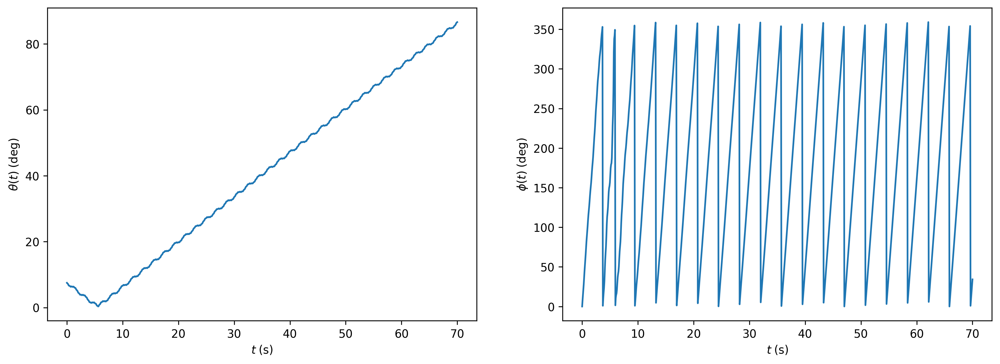

Precession frequency = 0.26488262903906706
Rotation frequency = 199.98461726997553
Gyros number (frequency) = 754.9933266498958
Gyros number (parameters) = 755.3797041269345
Gyros number gap = 0.05115010039688897 %
Larmor frequency =  0.2647471413083797  Hz


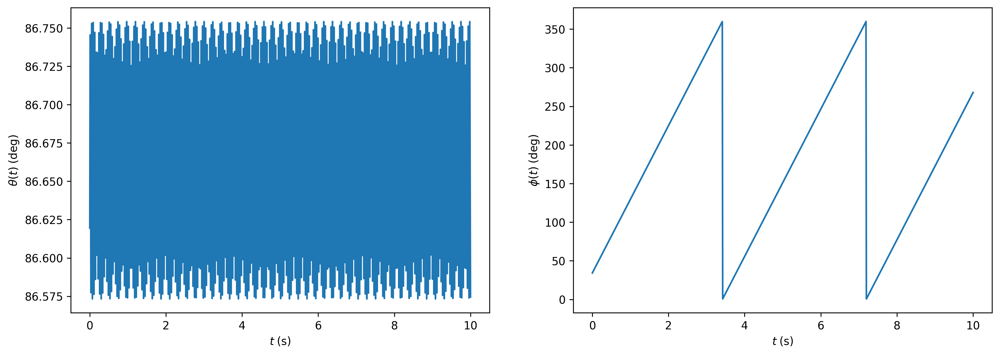

Precession frequency = 0.2651559381957435
Rotation frequency = 199.98287825639386
Gyros number (frequency) = 754.2085597523463
Gyros number (parameters) = 755.3665670179777
Gyros number gap = 0.15330401373241875 %
Larmor frequency =  0.26474944349983953  Hz


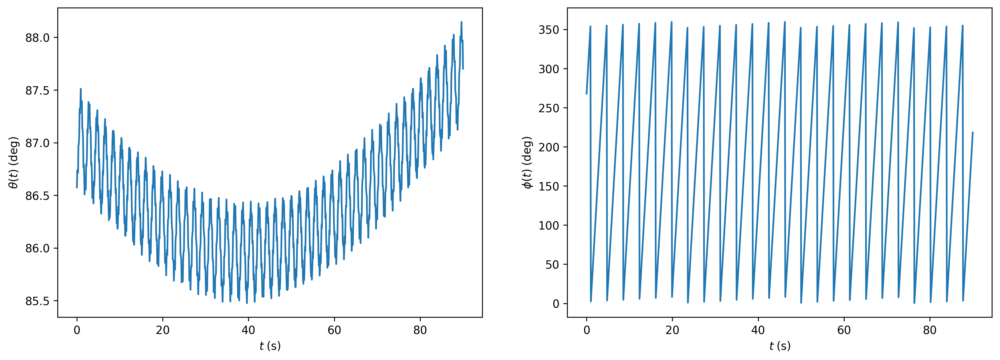

Precession frequency = 0.26483010640243815
Rotation frequency = 199.98978698659542
Gyros number (frequency) = 755.1625821676377
Gyros number (parameters) = 755.4187586256113
Gyros number gap = 0.033911847574414546 %
Larmor frequency =  0.26474029762042384  Hz


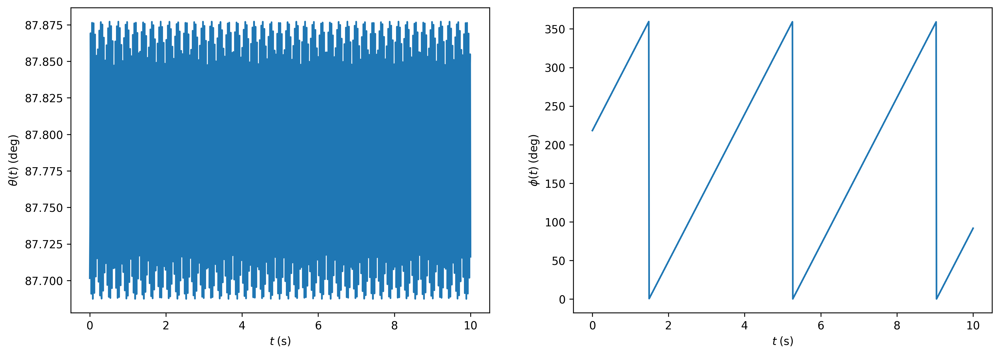

In [17]:
T, X, Y, Z = Demo(70, 10, 90, 10, params_f, CI, 0, np.pi, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path1 = HTML(fig.to_html(default_width=1000, default_height=600))

#path1

Precession frequency = 0.26582341436998336
Rotation frequency = 199.83114364072134
Gyros number (frequency) = 751.7439504504617
Gyros number (parameters) = 754.2207511835379
Gyros number gap = 0.32839201642085963 %
Larmor frequency =  0.2649504714994149  Hz


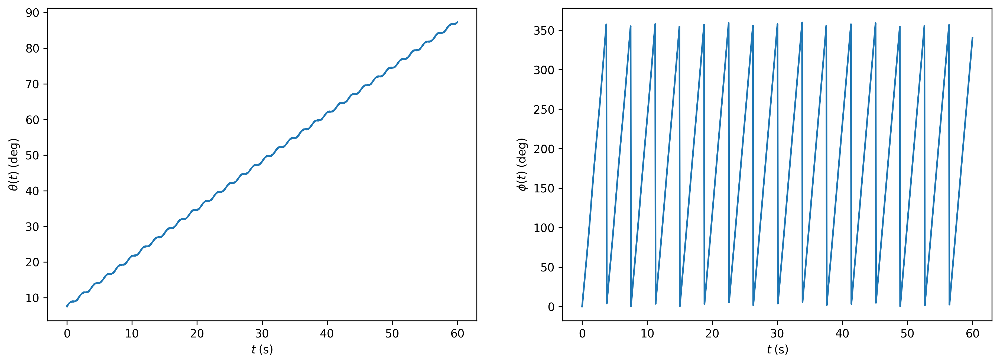

Precession frequency = 0.26485568416167476
Rotation frequency = 199.98726363573817
Gyros number (frequency) = 755.0801270085666
Gyros number (parameters) = 755.3996959067063
Gyros number gap = 0.04230461037664116 %
Larmor frequency =  0.26474363799642975  Hz


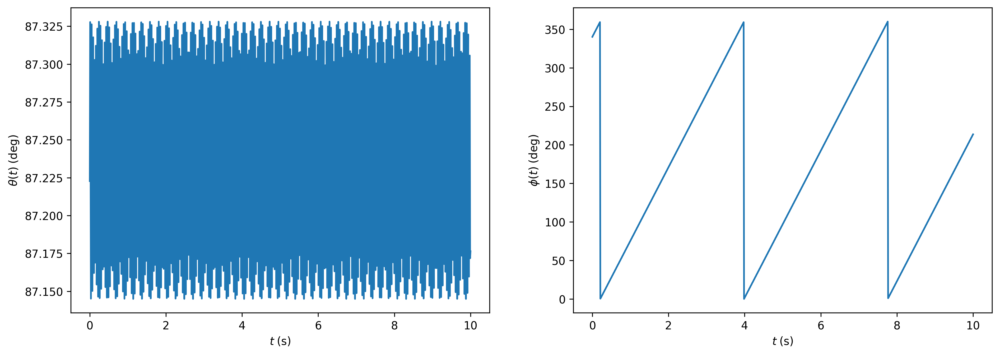

Precession frequency = 0.2689221471466727
Rotation frequency = 199.84102854296762
Gyros number (frequency) = 743.1185220827961
Gyros number (parameters) = 754.2953700107853
Gyros number gap = 1.4817601131277547 %
Larmor frequency =  0.2649373660348866  Hz


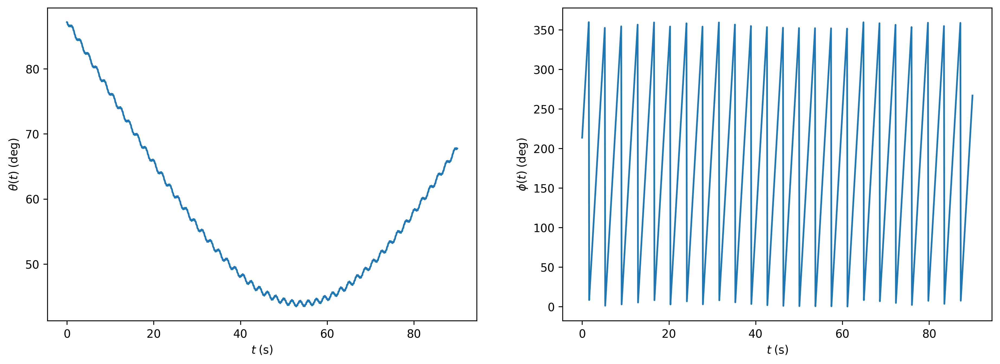

Precession frequency = 0.2657537523995796
Rotation frequency = 199.8990301282845
Gyros number (frequency) = 752.1964537596524
Gyros number (parameters) = 754.7332848533403
Gyros number gap = 0.3361228588428836 %
Larmor frequency =  0.26486049328953193  Hz


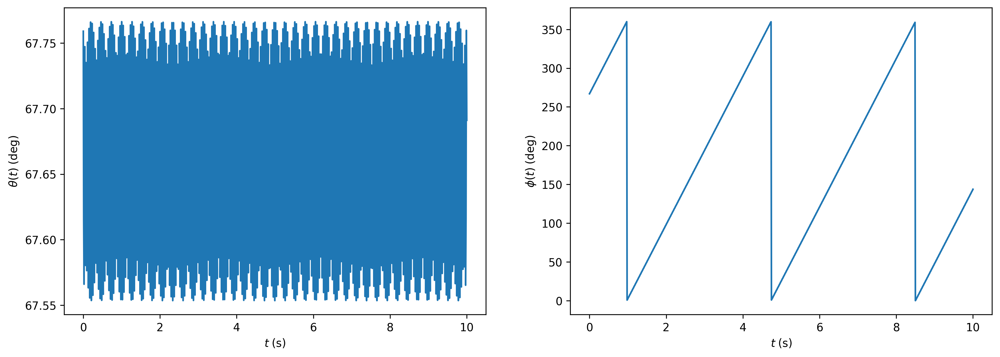

In [13]:
T, X, Y, Z = Demo(60, 10, 90, 10, params_f, CI, np.pi, np.pi, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path11 = HTML(fig.to_html(default_width=1000, default_height=600))

#path11

Precession frequency = 0.26582341436998336
Rotation frequency = 199.83114364072134
Gyros number (frequency) = 751.7439504504617
Gyros number (parameters) = 754.2207511835379
Gyros number gap = 0.32839201642085963 %
Larmor frequency =  0.2649504714994149  Hz


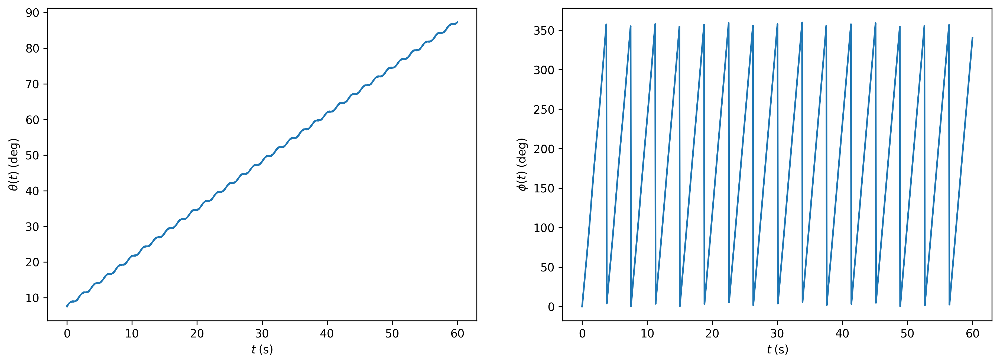

Precession frequency = 0.26485568416167476
Rotation frequency = 199.98726363573817
Gyros number (frequency) = 755.0801270085666
Gyros number (parameters) = 755.3996959067063
Gyros number gap = 0.04230461037664116 %
Larmor frequency =  0.26474363799642975  Hz


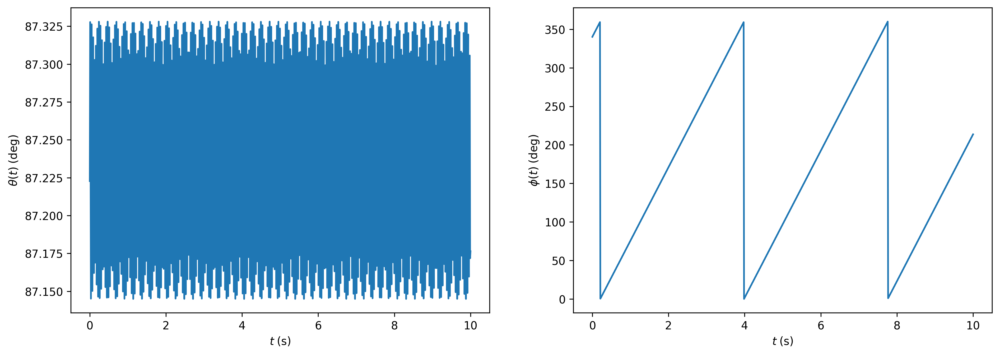

Precession frequency = 0.2674030239901857
Rotation frequency = 200.18548049876264
Gyros number (frequency) = 748.6283345326339
Gyros number (parameters) = 756.8978629304188
Gyros number gap = 1.0925553899397324 %
Larmor frequency =  0.26448149783871905  Hz


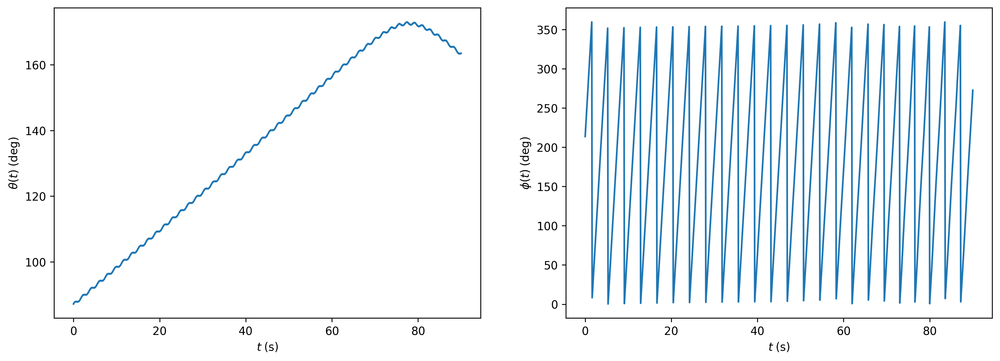

Precession frequency = 0.2622026996614779
Rotation frequency = 200.2513628802795
Gyros number (frequency) = 763.7273114991496
Gyros number (parameters) = 757.3961452164893
Gyros number gap = 0.8359121343099185 %
Larmor frequency =  0.2643944838444364  Hz


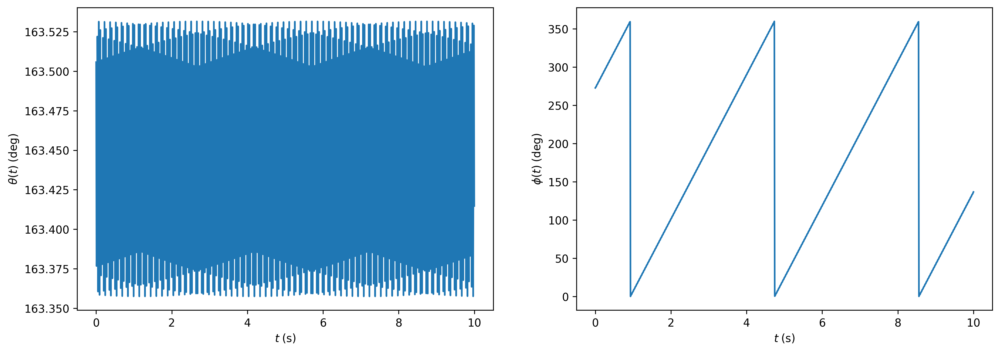

In [14]:
T, X, Y, Z = Demo(60, 10, 90, 10, params_f, CI, np.pi, 0, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path111 = HTML(fig.to_html(default_width=1000, default_height=600))

#path111

Precession frequency = 0.26582341436998336
Rotation frequency = 199.83114364072134
Gyros number (frequency) = 751.7439504504617
Gyros number (parameters) = 754.2207511835379
Gyros number gap = 0.32839201642085963 %
Larmor frequency =  0.2649504714994149  Hz


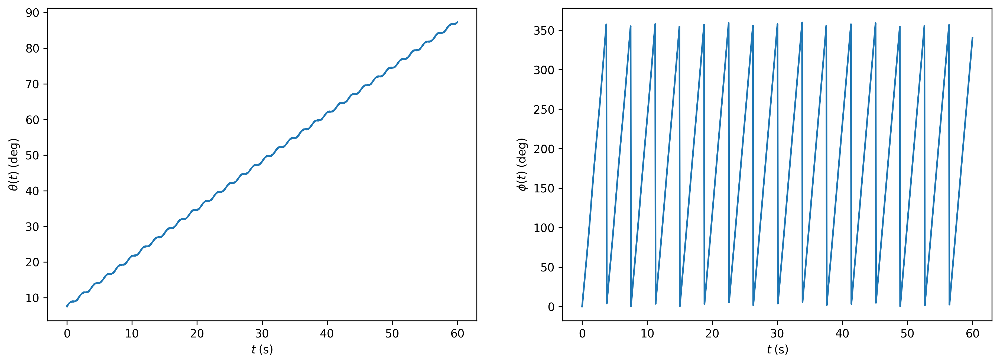

Precession frequency = 0.26485568416167476
Rotation frequency = 199.98726363573817
Gyros number (frequency) = 755.0801270085666
Gyros number (parameters) = 755.3996959067063
Gyros number gap = 0.04230461037664116 %
Larmor frequency =  0.26474363799642975  Hz


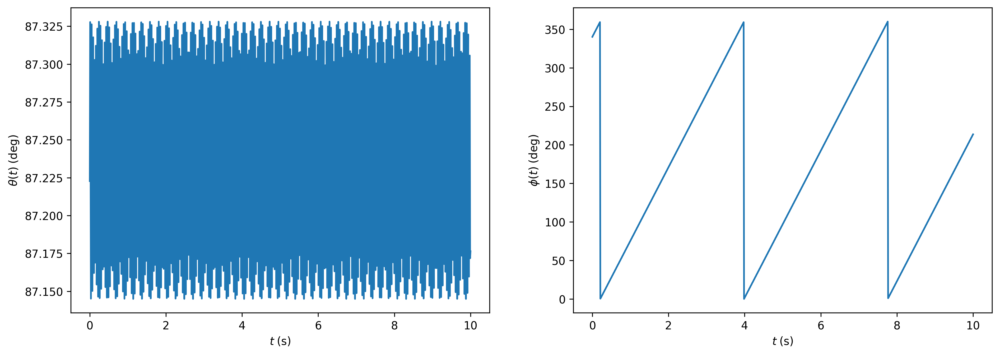

Precession frequency = 0.2720646845927093
Rotation frequency = 199.783828650106
Gyros number (frequency) = 734.3247395346059
Gyros number (parameters) = 753.8636324447224
Gyros number gap = 2.5918338634738682 %
Larmor frequency =  0.26501321996688215  Hz


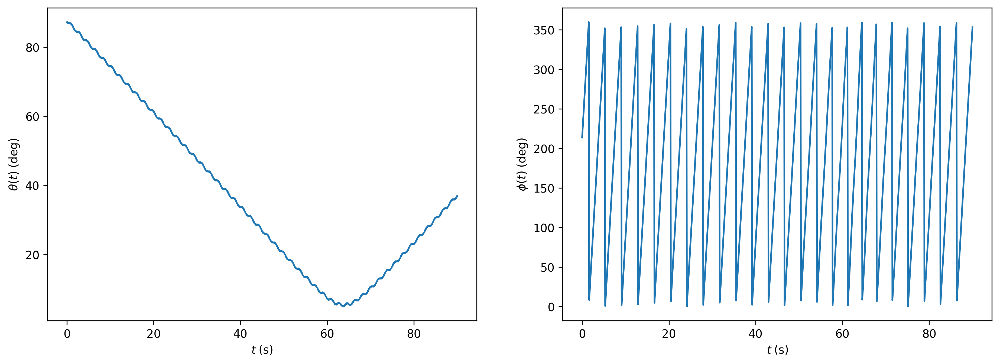

Precession frequency = 0.26690447699091296
Rotation frequency = 199.78688294666287
Gyros number (frequency) = 748.5332775196005
Gyros number (parameters) = 753.8866827657915
Gyros number gap = 0.7101074164821406 %
Larmor frequency =  0.26500916850487755  Hz


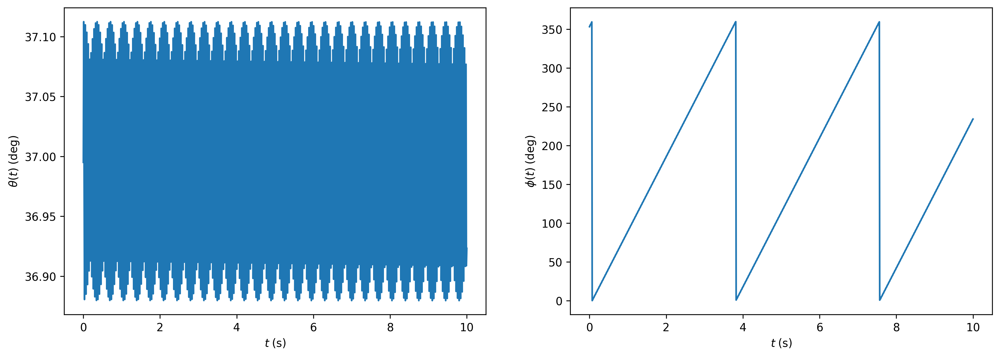

In [24]:
T, X, Y, Z = Demo(60, 10, 90, 10, params_f, CI, np.pi,  5 * np.pi / 4, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path1111 = HTML(fig.to_html(default_width=1000, default_height=600))

#path1111

Precession frequency = 0.2657986335536149
Rotation frequency = 199.84416442864244
Gyros number (frequency) = 751.8630241126932
Gyros number (parameters) = 754.3190428533575
Gyros number gap = 0.3255941585902296 %
Larmor frequency =  0.26493320872915166  Hz


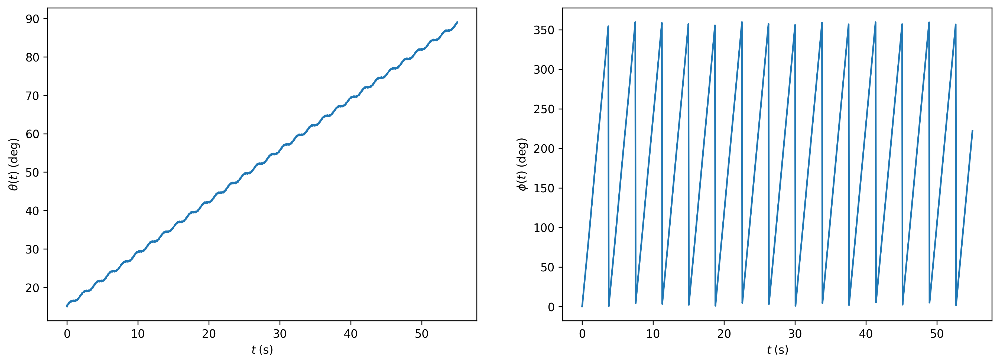

Precession frequency = 0.2647752494277718
Rotation frequency = 199.9951198521289
Gyros number (frequency) = 755.3391802457189
Gyros number (parameters) = 755.4590466866557
Gyros number gap = 0.015866702697188925 %
Larmor frequency =  0.26473323832612927  Hz


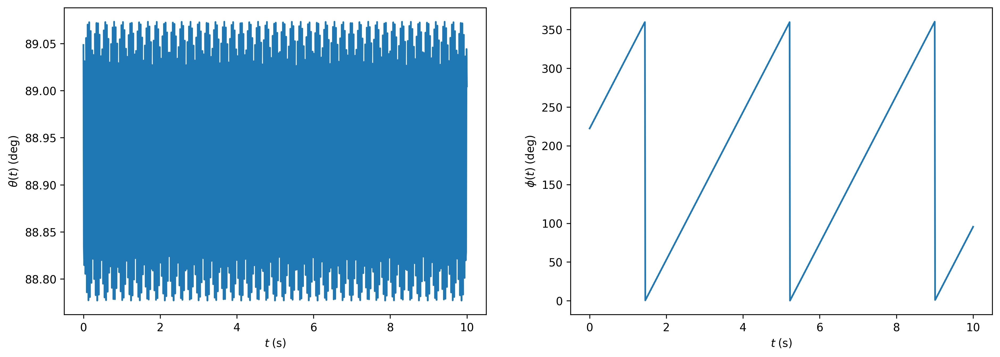

Precession frequency = 0.2708176050775242
Rotation frequency = 199.795860355982
Gyros number (frequency) = 737.7506358893783
Gyros number (parameters) = 753.9544359765158
Gyros number gap = 2.149174978478708 %
Larmor frequency =  0.2649972608718828  Hz


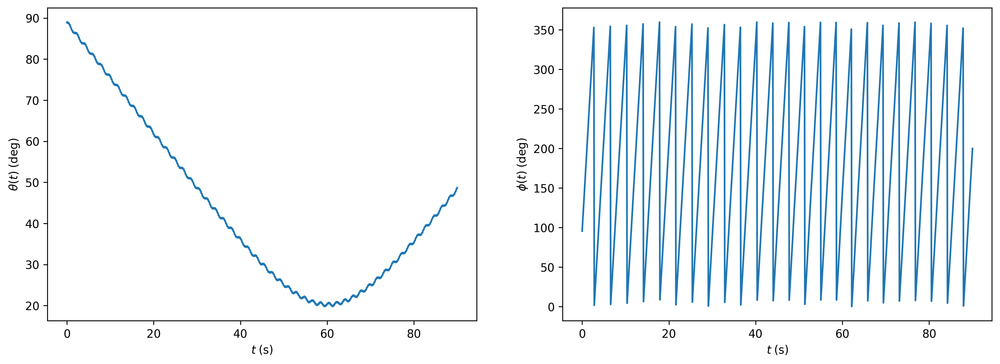

Precession frequency = 0.2665192925811071
Rotation frequency = 199.8242990332047
Gyros number (frequency) = 749.7554758531944
Gyros number (parameters) = 754.1690849965916
Gyros number gap = 0.5852280650587907 %
Larmor frequency =  0.2649595468821263  Hz


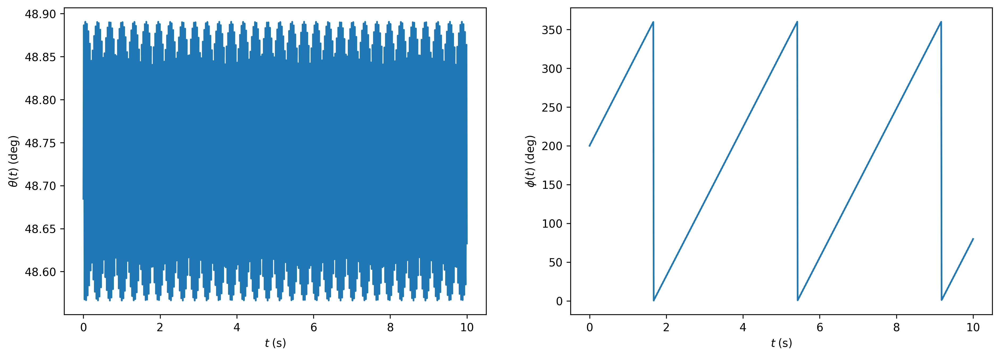

In [4]:
T, X, Y, Z = Demo(55, 10, 90, 10, params_f, CI, np.pi,  np.pi/2, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path2 = HTML(fig.to_html(default_width=1000, default_height=600))

#path2

Precession frequency = 0.2657986335536149
Rotation frequency = 199.84416442864244
Gyros number (frequency) = 751.8630241126932
Gyros number (parameters) = 754.3190428533575
Gyros number gap = 0.3255941585902296 %
Larmor frequency =  0.26493320872915166  Hz


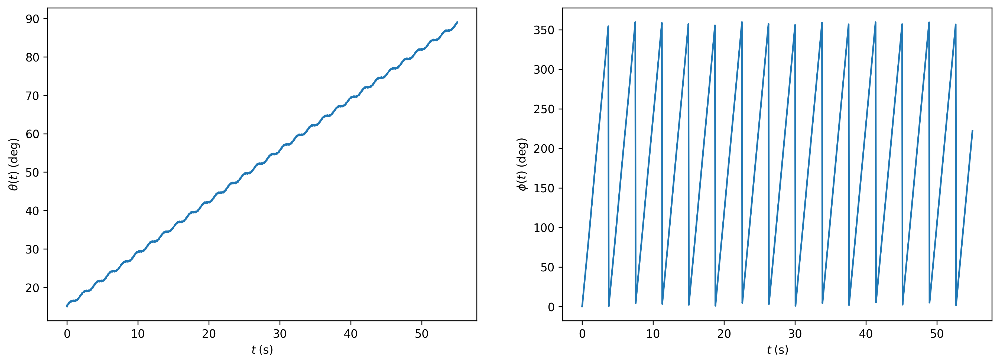

Precession frequency = 0.2647752494277718
Rotation frequency = 199.9951198521289
Gyros number (frequency) = 755.3391802457189
Gyros number (parameters) = 755.4590466866557
Gyros number gap = 0.015866702697188925 %
Larmor frequency =  0.26473323832612927  Hz


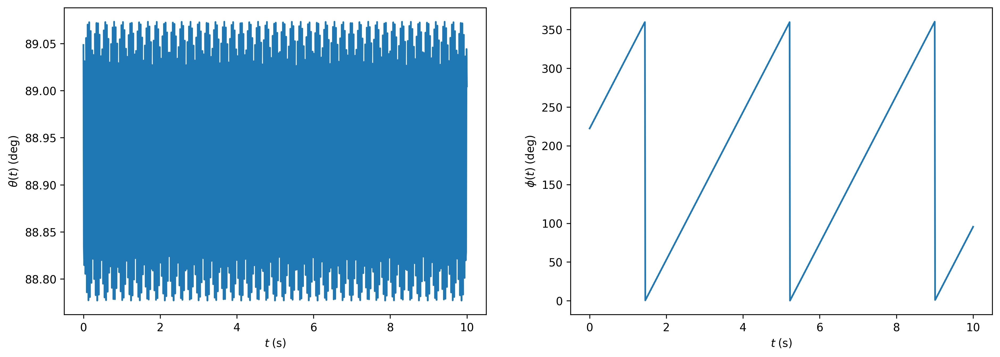

Precession frequency = 0.26466610403127105
Rotation frequency = 199.982162719301
Gyros number (frequency) = 755.6017173082071
Gyros number (parameters) = 755.3611616369253
Gyros number gap = 0.03184644425726784 %
Larmor frequency =  0.26475039077455925  Hz


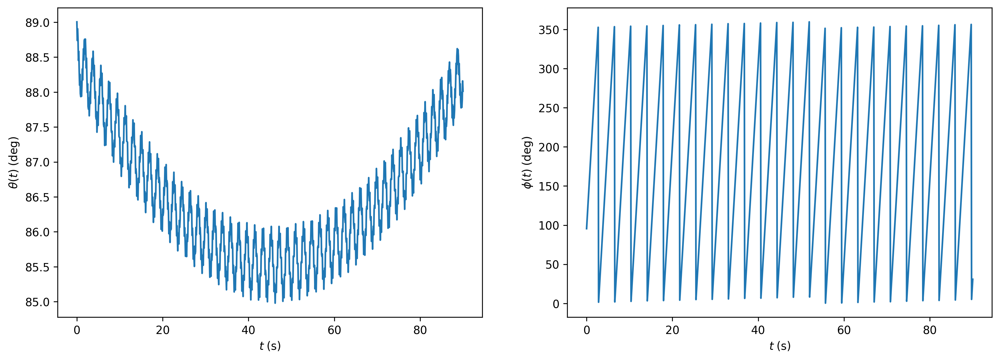

Precession frequency = 0.26481268613129166
Rotation frequency = 199.99146440919137
Gyros number (frequency) = 755.2185936818656
Gyros number (parameters) = 755.4314308908141
Gyros number gap = 0.028174259137921397 %
Larmor frequency =  0.26473807711887093  Hz


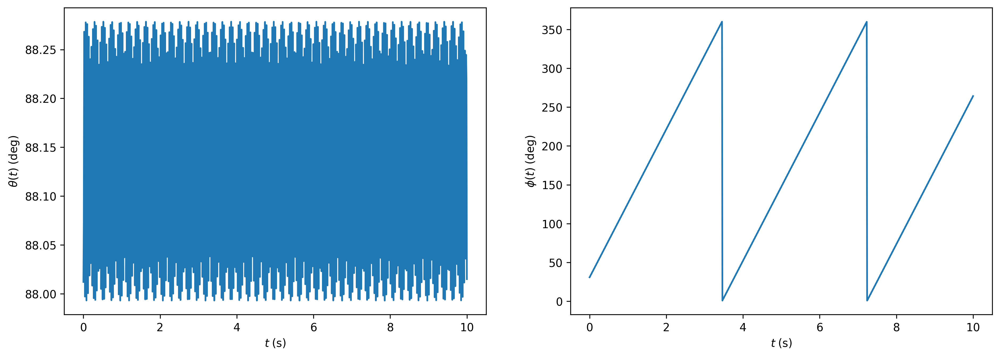

In [5]:
T, X, Y, Z = Demo(55, 10, 90, 10, params_f, CI, np.pi,  np.pi, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path3 = HTML(fig.to_html(default_width=1000, default_height=600))

#path3

Precession frequency = 0.2657986335536149
Rotation frequency = 199.84416442864244
Gyros number (frequency) = 751.8630241126932
Gyros number (parameters) = 754.3190428533575
Gyros number gap = 0.3255941585902296 %
Larmor frequency =  0.26493320872915166  Hz


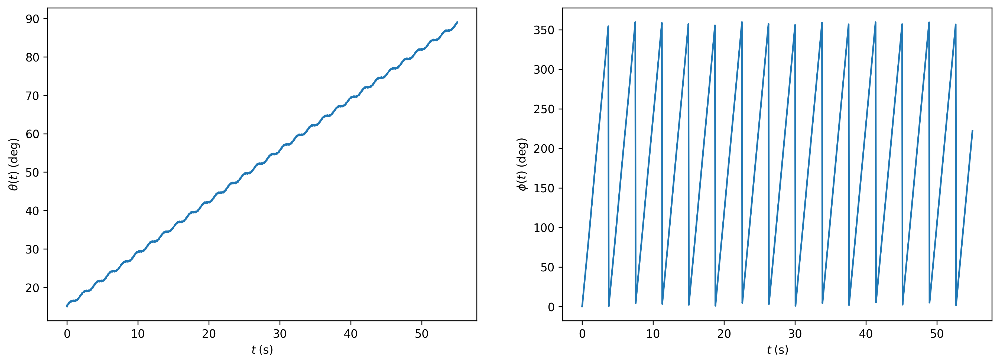

Precession frequency = 0.2647752494277718
Rotation frequency = 199.9951198521289
Gyros number (frequency) = 755.3391802457189
Gyros number (parameters) = 755.4590466866557
Gyros number gap = 0.015866702697188925 %
Larmor frequency =  0.26473323832612927  Hz


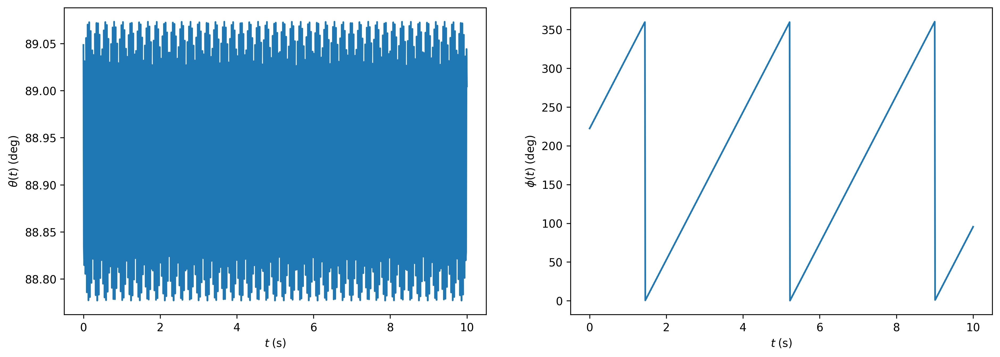

Precession frequency = 0.26488009888768377
Rotation frequency = 199.99424447091482
Gyros number (frequency) = 755.0368838986191
Gyros number (parameters) = 755.4524333931846
Gyros number gap = 0.055006705412154154 %
Larmor frequency =  0.2647343970719931  Hz


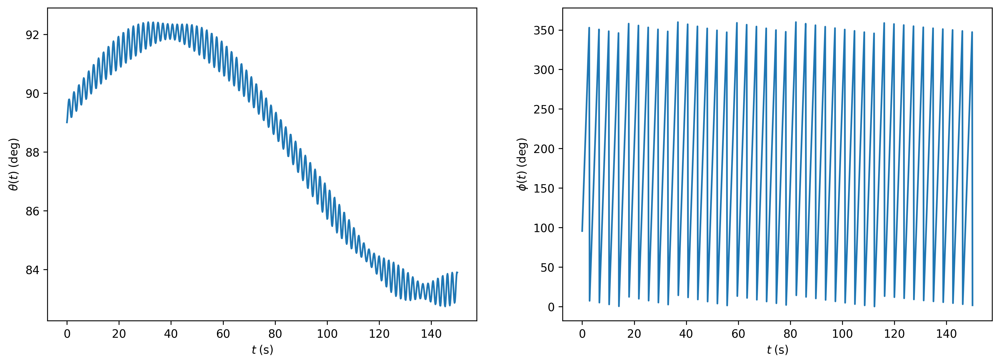

Precession frequency = 0.2650142833459215
Rotation frequency = 199.9715988665943
Gyros number (frequency) = 754.5691362060385
Gyros number (parameters) = 755.28136138686
Gyros number gap = 0.09429931906617159 %
Larmor frequency =  0.26476437668129815  Hz


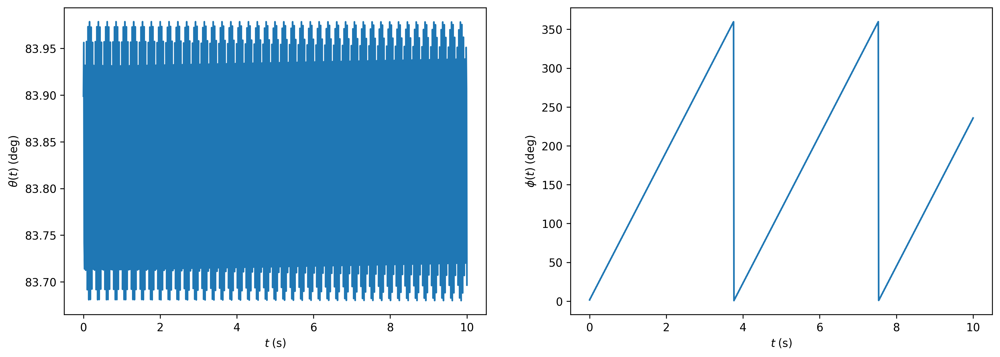

In [6]:
T, X, Y, Z = Demo(55, 10, 150, 10, params_f, CI, np.pi,  0, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path4 = HTML(fig.to_html(default_width=1000, default_height=600))

#path4

Precession frequency = 0.2657986335536149
Rotation frequency = 199.84416442864244
Gyros number (frequency) = 751.8630241126932
Gyros number (parameters) = 754.3190428533575
Gyros number gap = 0.3255941585902296 %
Larmor frequency =  0.26493320872915166  Hz


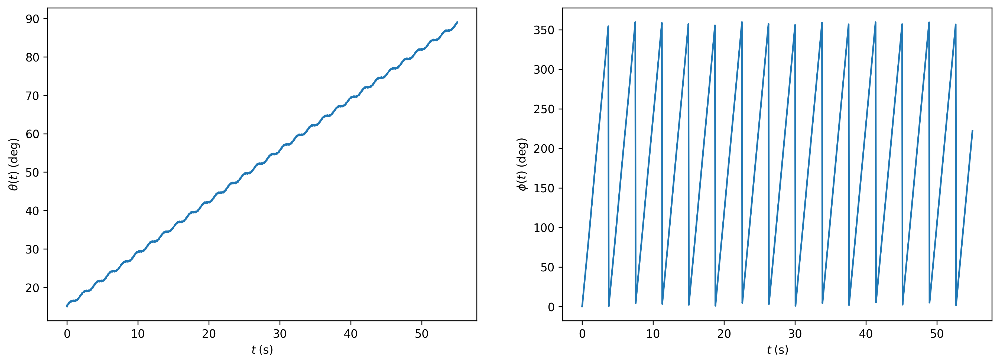

Precession frequency = 0.2647752494277718
Rotation frequency = 199.9951198521289
Gyros number (frequency) = 755.3391802457189
Gyros number (parameters) = 755.4590466866557
Gyros number gap = 0.015866702697188925 %
Larmor frequency =  0.26473323832612927  Hz


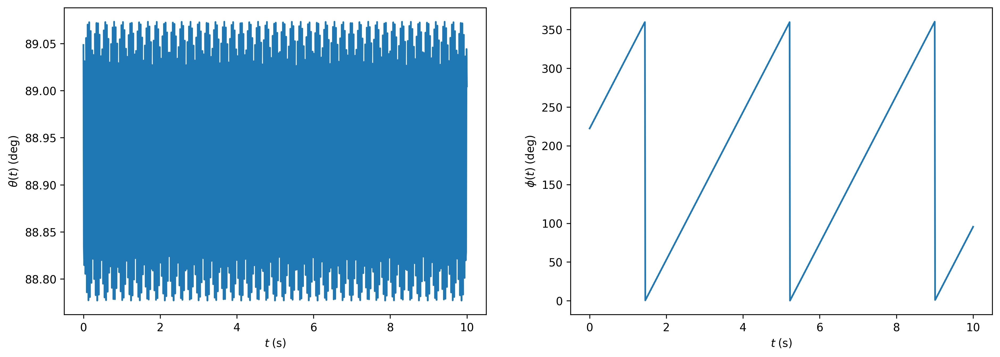

Precession frequency = 0.27047005205142954
Rotation frequency = 199.80292807989994
Gyros number (frequency) = 738.7247740164137
Gyros number (parameters) = 754.0077787839402
Gyros number gap = 2.026902798294059 %
Larmor frequency =  0.26498788699785175  Hz


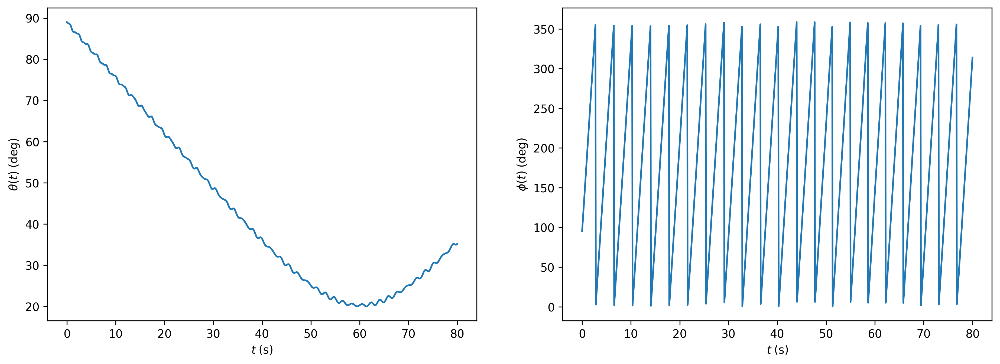

Precession frequency = 0.2669520486402128
Rotation frequency = 199.78227576365356
Gyros number (frequency) = 748.3826281959425
Gyros number (parameters) = 753.8519131771517
Gyros number gap = 0.725511852607571 %
Larmor frequency =  0.2650152798865493  Hz


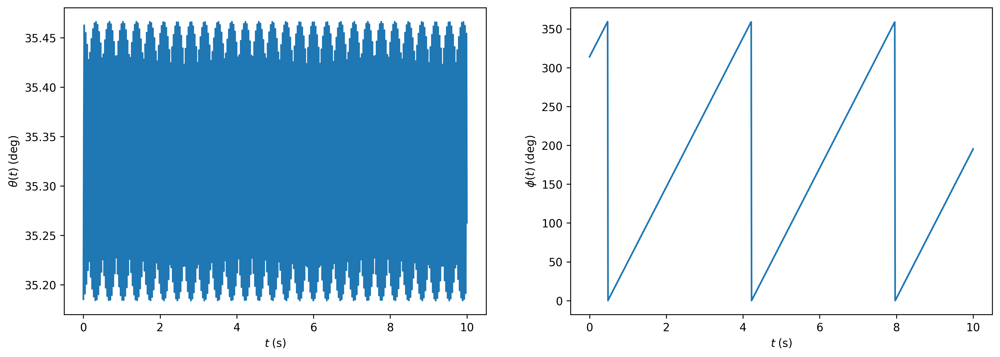

In [10]:
T, X, Y, Z = Demo(55, 10, 80, 10, params_f, CI, np.pi,  np.pi/2, bool_plot=True)

x, y, z = X, Y, Z

if True:
    i = 0
    f = len(X)

    layout = go.Layout(
        title=r"Plot Title",
        scene=dict(
            xaxis_title=r"x",
            yaxis_title=r"y",
            zaxis_title=r"z",
            aspectratio=dict(x=1, y=1, z=1),
            camera_eye=dict(x=1.2, y=1.2, z=1.2),
        ),
    )

    fig = go.Figure(layout=layout)
    fig.add_scatter3d(x=[0], y=[0], z=[0])
    fig.add_scatter3d(
        x=x[i:f], y=y[i:f], z=z[i:f], mode="lines", line=dict(color="green", width=2)
    )

    fig.update_layout(
        scene=dict(
            xaxis=dict(
                range=[-1, 1],
            ),
            yaxis=dict(
                range=[-1, 1],
            ),
            zaxis=dict(
                range=[-1, 1],
            ),
        )
    )

    path5 = HTML(fig.to_html(default_width=1000, default_height=600))

#path5